# 環境構築



*   Pythonモジュールへのパス追加





In [1]:
!pwd

/mnt/MachineLearning/NoteBook/NumDropletsRoI


In [2]:
# import os

# os.chdir("/mnt/MachineLearning")

In [3]:
import sys
sys.path.append('/mnt/MachineLearning/modules')

In [4]:
%matplotlib inline
import os
import glob
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy import interpolate
import show_mod

# 前処理

In [70]:
#読み込むデータのパスの設定

# data_path = './data'
# input_list = glob.glob(data_path+"/*"+"/inputdata.csv")

# input_list

In [67]:
#input(空調条件等)の読み込み
# df_input = None

# for input_fname in input_list:
#     df_read = pd.read_csv(input_fname, index_col="case_name")
#     if df_input is None:
#         df_input = df_read
#     else:
#         df_input = pd.concat([df_input, df_read])

# df_input

In [68]:
#空調条件のみ抽出
# df_meta = df_input.loc[:, ['aircon', 'ventilation', 'exhaust']]

# df_meta

In [69]:
#排気口位置a,b,offをダミー変数化

# df_meta = pd.get_dummies(df_meta, columns=['exhaust'])
# # dummies = pd.get_dummies(df_input['exhaust'])
# # df_input.drop("exhaust", axis=1, inplace=True)
# # df_input = pd.concat([df_input, dummies], axis=1)
# # df_input = df_input.reindex(columns=['aircon','ventilation','exhaust_a','b','off'
# #           ,'1_x','1_y','1_z','1_angle','2_x','2_y','2_z','2_angle','3_x','3_y','3_z','3_angle'
# #           ,'4_x','4_y','4_z','4_angle','5_x','5_y','5_z','5_angle',"office_size_x","office_size_y"
# #           ,"aircon_position_x","aircon_position_y"])

# df_meta

# データ追加（2022/10/26）

- データ数：from 263 to 431
- オフィス数：from 9 to 15 (ID : 1,2,3,4,5,6,7,8,9,10,14,15,16,22,28)

In [5]:
# df_count = pd.read_csv("./CountResults/data_added_221018/sitting/count_from2sec_patientAverage.csv", index_col="casename")
df_count = pd.read_csv("/mnt/MachineLearning/CountResults/data_added_221018/sitting/count_from2sec_patientAverage.csv")
df_count

,casename,num_drop,volume[ml],RoI
0,office2_0_0,6739.4,0.000067,204.224242
1,office2_0_164_aout,7865.4,0.000063,238.345455
2,office2_0_164_bout,6049.8,0.000062,183.327273
3,office2_0_246_aout,7934.4,0.000050,240.436364
4,office2_0_246_bout,7662.0,0.000082,232.181818
...,...,...,...,...
426,office3_960_164_bout,5117.4,0.000075,155.072727
427,office3_960_246_aout,4428.0,0.000073,134.181818
428,office3_960_246_bout,3890.0,0.000066,117.878788
429,office3_960_82_aout,5221.2,0.000072,158.218182


In [6]:
def get_val_from_casename(casename:str, index:int):
    return float(casename.split("_")[index])

print(get_val_from_casename("office2_0_164_aout", 2))

164.0


In [22]:
def get_exhaust_from_casename(casename:str):
    s_split = casename.split("_")
    if len(s_split) == 4:
        exhaust_str = s_split[3]
        if exhaust_str == "aout":
            exhaust = "a"
        elif exhaust_str == "bout":
            exhaust = "b"
    else:
        exhaust = "off"
        
    return exhaust

print(get_exhaust_from_casename("office2_0_164"))

off


In [23]:
df_count["aircon"] = df_count["casename"].apply(get_val_from_casename, args=(1,))
df_count["ventilation"] = df_count["casename"].apply(get_val_from_casename, args=(2,))
df_count["exhaust"] = df_count["casename"].apply(get_exhaust_from_casename)
                                                     
df_count

,casename,num_drop,volume[ml],RoI,aircon,ventilation,exhaust
0,office2_0_0,6739.4,0.000067,204.224242,0.0,0.0,off
1,office2_0_164_aout,7865.4,0.000063,238.345455,0.0,164.0,a
2,office2_0_164_bout,6049.8,0.000062,183.327273,0.0,164.0,b
3,office2_0_246_aout,7934.4,0.000050,240.436364,0.0,246.0,a
4,office2_0_246_bout,7662.0,0.000082,232.181818,0.0,246.0,b
...,...,...,...,...,...,...,...
426,office3_960_164_bout,5117.4,0.000075,155.072727,960.0,164.0,b
427,office3_960_246_aout,4428.0,0.000073,134.181818,960.0,246.0,a
428,office3_960_246_bout,3890.0,0.000066,117.878788,960.0,246.0,b
429,office3_960_82_aout,5221.2,0.000072,158.218182,960.0,82.0,a


In [24]:
df_summary = df_count

In [7]:
df_summary.to_csv("/mnt/MachineLearning/data/summary_221015.csv", index=False)

NameError: name 'df_summary' is not defined

In [8]:
df_summary = pd.read_csv("/mnt/MachineLearning/data/summary_221015.csv")

df_summary

,casename,num_drop,volume[ml],RoI,aircon,ventilation,exhaust
0,office2_0_0,6739.4,0.000067,204.224242,0.0,0.0,off
1,office2_0_164_aout,7865.4,0.000063,238.345455,0.0,164.0,a
2,office2_0_164_bout,6049.8,0.000062,183.327273,0.0,164.0,b
3,office2_0_246_aout,7934.4,0.000050,240.436364,0.0,246.0,a
4,office2_0_246_bout,7662.0,0.000082,232.181818,0.0,246.0,b
...,...,...,...,...,...,...,...
426,office3_960_164_bout,5117.4,0.000075,155.072727,960.0,164.0,b
427,office3_960_246_aout,4428.0,0.000073,134.181818,960.0,246.0,a
428,office3_960_246_bout,3890.0,0.000066,117.878788,960.0,246.0,b
429,office3_960_82_aout,5221.2,0.000072,158.218182,960.0,82.0,a


In [9]:
#排気口位置a,b,offをダミー変数化

df_total = pd.get_dummies(df_summary, columns=['exhaust'])
df_total

,casename,num_drop,volume[ml],RoI,aircon,ventilation,exhaust_a,exhaust_b,exhaust_off
0,office2_0_0,6739.4,0.000067,204.224242,0.0,0.0,0,0,1
1,office2_0_164_aout,7865.4,0.000063,238.345455,0.0,164.0,1,0,0
2,office2_0_164_bout,6049.8,0.000062,183.327273,0.0,164.0,0,1,0
3,office2_0_246_aout,7934.4,0.000050,240.436364,0.0,246.0,1,0,0
4,office2_0_246_bout,7662.0,0.000082,232.181818,0.0,246.0,0,1,0
...,...,...,...,...,...,...,...,...,...
426,office3_960_164_bout,5117.4,0.000075,155.072727,960.0,164.0,0,1,0
427,office3_960_246_aout,4428.0,0.000073,134.181818,960.0,246.0,1,0,0
428,office3_960_246_bout,3890.0,0.000066,117.878788,960.0,246.0,0,1,0
429,office3_960_82_aout,5221.2,0.000072,158.218182,960.0,82.0,1,0,0


In [16]:
# # df_meta.join(df_count)
# df_total = pd.merge(df_meta, df_count, left_index=True, right_index=True)

# df_total

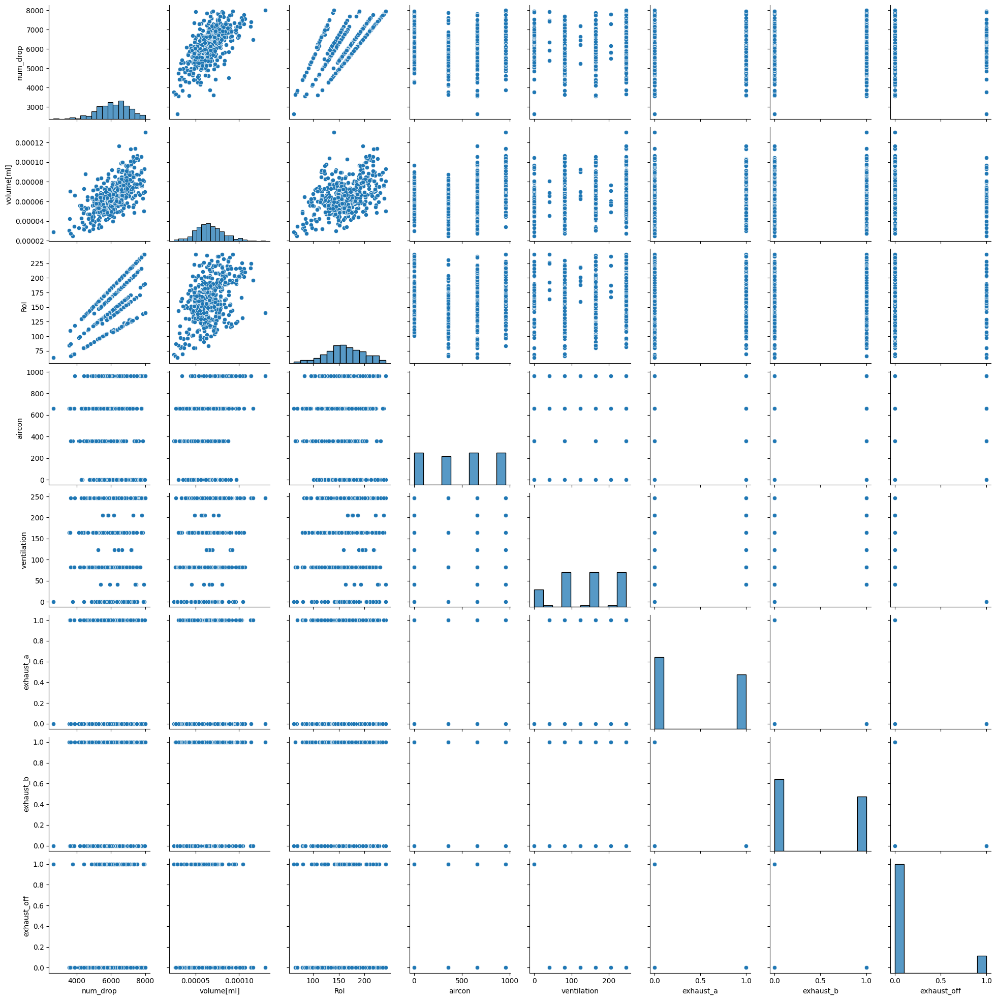

In [28]:
import seaborn as sns

sns.pairplot(df_total)

In [10]:
df_total.std(numeric_only=True)

num_drop       921.844114
volume[ml]       0.000017
RoI             36.376848
aircon         360.876287
ventilation     83.985694
exhaust_a        0.495869
exhaust_b        0.495869
exhaust_off      0.344132
dtype: float64

In [11]:
from sklearn import preprocessing

#入力データの標準化
stdscaler = preprocessing.StandardScaler()
df_total_numeric = df_total.drop(columns='casename')
stdscaler.fit(df_total_numeric)
df_total_tf = stdscaler.transform(df_total_numeric)

df_total_standardized = pd.DataFrame(df_total_tf, index=df_total["casename"], columns=df_total_numeric.columns)
# df_total_standardized = pd.DataFrame(df_total_tf, index=df_total.index, columns=df_total.columns)
df_total_standardized

# df_input_std = df_input.copy()
# for i in range(int(input_std.shape[1])):
#     df_input_std.iloc[:, i] = input_std[:, i]


,num_drop,volume[ml],RoI,aircon,ventilation,exhaust_a,exhaust_b,exhaust_off
casename,,,,,,,,
office2_0_0,0.661649,0.020994,1.164784,-1.384552,-1.666952,-0.871311,-0.871311,2.510993
office2_0_164_aout,1.884534,-0.192421,2.103867,-1.384552,0.288031,1.147695,-0.871311,-0.398249
office2_0_164_bout,-0.087286,-0.264988,0.589659,-1.384552,0.288031,-0.871311,1.147695,-0.398249
office2_0_246_aout,1.959471,-0.952853,2.161413,-1.384552,1.265523,1.147695,-0.871311,-0.398249
office2_0_246_bout,1.663633,0.965142,1.934231,-1.384552,1.265523,-0.871311,1.147695,-0.398249
...,...,...,...,...,...,...,...,...
office3_960_164_bout,-1.099912,0.544731,-0.187962,1.278731,0.288031,-0.871311,1.147695,-0.398249
office3_960_246_aout,-1.848630,0.388243,-0.762921,1.278731,1.265523,1.147695,-0.871311,-0.398249
office3_960_246_bout,-2.432921,0.009982,-1.211612,1.278731,1.265523,-0.871311,1.147695,-0.398249


In [12]:
df_meta_standardized = df_total_standardized[["aircon", "ventilation", "exhaust_a", "exhaust_b", "exhaust_off"]]

df_RoI_standardized = df_total_standardized["RoI"]

In [13]:
# import numpy as np
# import pointCloud_sampling as pcs

# # rng = np.random.default_rng()

# #予め点群をサンプリングしておいたものを取得
# sampledPointCloud_dict = pcs.read_sampledPointCloud('/content/drive/MyDrive/ML/PointNetTrial/data/pointCloud_sampled')

# sampledPointCloud_dict

In [48]:
import os
import random
import numpy as np
import json
import glob
from stl import mesh
from enum import Enum, auto

# 列挙型の定義
class OfficePart(Enum):
    aircon = auto()
    airvent = auto()
    body = auto()
    room = auto()
    desks = auto()


"""
データの前処理

オフィスモデル（STLファイル）を読み込み、点群情報のみ取り出し、
ランダムサンプリングで指定個の点群(ndarray)にする。
"""
officemodel_path = '/mnt/MachineLearning/OfficeModel/model_origin'
# office_list = os.listdir(officemodel_path)
# case_list = [s.replace('office', 'case') for s in os.listdir(data_path)]
case_list = os.listdir(officemodel_path)
print(case_list)
# office_list = ['office1', 'office2', 'office3', 'office7', 'office10', 'office15', 'office16', 'office22', 'office28']
# print(office_list)

# 列挙型のメンバーの列挙
for part in OfficePart:
    print(part)
    
NUM_POINTS = 2048

sampledPointCloud_dict = {}
for casename in case_list:
    officename = casename.replace('case', 'office') 
    pc_dict = {}
    for part in OfficePart:
        path = officemodel_path + '/' + casename + '/' + part.name
        # print(path)
        stl_list = glob.glob(path + "/*.stl")
        print(stl_list)
        pc_list = []
        for stlfname in stl_list:
            for mesh_read in mesh.Mesh.from_multi_file(stlfname):
                points = mesh_read.points.reshape([-1, 3])
                pc_list.append(points)

        points_concat = np.concatenate(pc_list)
        points_concat = np.unique(points_concat, axis=0)
        pc_dict[part] = points_concat.copy()
                        

    pc_aircon = pc_dict[OfficePart.aircon]
    pc_airvent = pc_dict[OfficePart.airvent]
    pc_room = pc_dict[OfficePart.room]
    pc_base = np.concatenate([pc_aircon, pc_airvent, pc_room])
    num_sampling = NUM_POINTS - len(pc_base)

#     pc_forSampling = np.concatenate([pc_dict[OfficePart.body], pc_dict[OfficePart.desks]])
# #     pc_forSampling = pc_dict[OfficePart.desks]
#     print(f'#sampling {num_sampling} from {len(pc_forSampling)}', )
#     rand_list = random.sample(range(len(pc_forSampling)), k=num_sampling)
#     pc_sampled = pc_forSampling[rand_list, :]
    
    num_sampling_body = num_sampling // 2
    num_sampling_desks = num_sampling - num_sampling_body
    
    print("num_sampling_body = ", num_sampling_body)
    pc_body = pc_dict[OfficePart.body]
    rand_list = random.sample(range(len(pc_body)), k=num_sampling_body)
    pc_sampled_body = pc_body[rand_list, :]
    
    print("num_sampling_desks = ", num_sampling_desks)
    pc_desks = pc_dict[OfficePart.desks]
    rand_list = random.sample(range(len(pc_desks)), k=num_sampling_desks)
    pc_sampled_desks = pc_desks[rand_list, :]
    
    
#     pointCloud = np.concatenate([pc_base, pc_sampled])
    pointCloud = np.concatenate([pc_base, pc_sampled_body, pc_sampled_desks])
    print(pointCloud.shape)
    sampledPointCloud_dict[officename] = pointCloud


['case1', 'case10', 'case11', 'case12', 'case13', 'case14', 'case15', 'case16', 'case17', 'case18', 'case19', 'case2', 'case20', 'case21', 'case22', 'case23', 'case24', 'case25', 'case26', 'case27', 'case28', 'case29', 'case3', 'case30', 'case31', 'case32', 'case33', 'case4', 'case5', 'case6', 'case7', 'case8', 'case9']
OfficePart.aircon
OfficePart.airvent
OfficePart.body
OfficePart.room
OfficePart.desks
['/mnt/MachineLearning/OfficeModel/model_origin/case1/aircon/aircon_body.stl', '/mnt/MachineLearning/OfficeModel/model_origin/case1/aircon/aircon_inlets.stl', '/mnt/MachineLearning/OfficeModel/model_origin/case1/aircon/aircon_outlet.stl']
['/mnt/MachineLearning/OfficeModel/model_origin/case1/airvent/20210812_airvent_a.stl', '/mnt/MachineLearning/OfficeModel/model_origin/case1/airvent/airvent_b.stl']
['/mnt/MachineLearning/OfficeModel/model_origin/case1/body/20210810_bodies.stl']
['/mnt/MachineLearning/OfficeModel/model_origin/case1/room/20210810_office_bottom.stl', '/mnt/MachineLearnin

In [49]:
sampledPointCloud_dict

{'office1': array([[2.5     , 2.25    , 2.6     ],
        [2.5     , 2.375   , 2.6     ],
        [2.5     , 2.45    , 2.6     ],
        ...,
        [3.825   , 1.733333, 0.7     ],
        [0.925   , 2.875   , 0.05    ],
        [1.495   , 1.278333, 0.53    ]], dtype=float32),
 'office10': array([[3.      , 2.5     , 2.6     ],
        [3.      , 2.625   , 2.6     ],
        [3.      , 2.7     , 2.6     ],
        ...,
        [3.9725  , 2.275   , 0.7     ],
        [3.065   , 4.078333, 0.48    ],
        [1.485   , 2.533333, 0.7     ]], dtype=float32),
 'office11': array([[3.       , 2.5      , 2.6      ],
        [3.       , 2.625    , 2.6      ],
        [3.       , 2.7      , 2.6      ],
        ...,
        [3.96     , 4.305    , 0.53     ],
        [3.45     , 3.183333 , 0.75     ],
        [2.7      , 5.1      , 0.2833333]], dtype=float32),
 'office12': array([[3.      , 2.5     , 2.6     ],
        [3.      , 2.625   , 2.6     ],
        [3.      , 2.7     , 2.6     ],
     

In [14]:
import numpy as np

pcFilePath = '/mnt/MachineLearning/OfficeModel/PointCloud_sampled/PointCloud_dict_test.npy'

# np.save(pcFilePath, sampledPointCloud_dict, allow_pickle='TRUE')

a = np.load(pcFilePath, allow_pickle='TRUE')    # 0-D Array で返ってくる
sampledPointCloud_dict = a.item()
sampledPointCloud_dict

{'office1': array([[2.5     , 2.25    , 2.6     ],
        [2.5     , 2.375   , 2.6     ],
        [2.5     , 2.45    , 2.6     ],
        ...,
        [3.825   , 1.733333, 0.7     ],
        [0.925   , 2.875   , 0.05    ],
        [1.495   , 1.278333, 0.53    ]], dtype=float32),
 'office10': array([[3.      , 2.5     , 2.6     ],
        [3.      , 2.625   , 2.6     ],
        [3.      , 2.7     , 2.6     ],
        ...,
        [3.9725  , 2.275   , 0.7     ],
        [3.065   , 4.078333, 0.48    ],
        [1.485   , 2.533333, 0.7     ]], dtype=float32),
 'office11': array([[3.       , 2.5      , 2.6      ],
        [3.       , 2.625    , 2.6      ],
        [3.       , 2.7      , 2.6      ],
        ...,
        [3.96     , 4.305    , 0.53     ],
        [3.45     , 3.183333 , 0.75     ],
        [2.7      , 5.1      , 0.2833333]], dtype=float32),
 'office12': array([[3.      , 2.5     , 2.6     ],
        [3.      , 2.625   , 2.6     ],
        [3.      , 2.7     , 2.6     ],
     

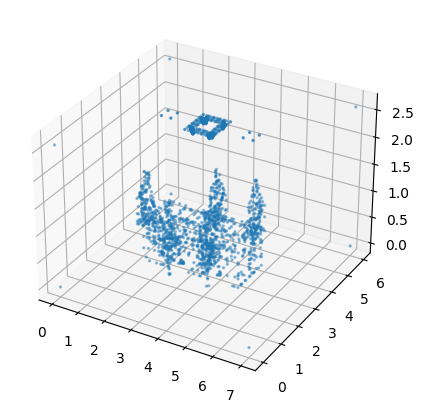

In [15]:
from matplotlib import pyplot as plt

def plot3d_points(point_cloud):
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(projection="3d")
    ax.scatter(point_cloud[:, 0], point_cloud[:, 1], point_cloud[:, 2], alpha=0.4, s=2)
    # ax.set_axis_off()
    plt.show()
    
plot3d_points(sampledPointCloud_dict['office10'])

In [16]:
import numpy as np
'''
点群シャッフルによるデータ増強
'''
rng = np.random.default_rng()

pointCloud_augumented_dict = {}
for office_name, pointCloud in sampledPointCloud_dict.items():
    pc_list = []
    for i in range(4):
        pc = pointCloud.copy()

        if i >= 1:
            #点群のシャッフル
            rng.shuffle(pc)

        pc_list.append(pc)

    pointCloud_augumented_dict[office_name] = pc_list

pointCloud_augumented_dict

{'office1': [array([[2.5     , 2.25    , 2.6     ],
         [2.5     , 2.375   , 2.6     ],
         [2.5     , 2.45    , 2.6     ],
         ...,
         [3.825   , 1.733333, 0.7     ],
         [0.925   , 2.875   , 0.05    ],
         [1.495   , 1.278333, 0.53    ]], dtype=float32),
  array([[1.526398 , 1.005136 , 0.7309407],
         [2.023385 , 2.786458 , 0.1474766],
         [1.45     , 1.475    , 0.7      ],
         ...,
         [2.875    , 3.25     , 2.6      ],
         [3.18     , 2.3      , 2.6      ],
         [2.7      , 3.2      , 2.6      ]], dtype=float32),
  array([[5.013685 , 2.169001 , 0.9329508],
         [2.7      , 2.4      , 2.516167 ],
         [3.059893 , 1.404504 , 0.6856333],
         ...,
         [2.65     , 3.05     , 2.5625   ],
         [1.812337 , 3.361628 , 1.335795 ],
         [3.3      , 3.1375   , 2.6      ]], dtype=float32),
  array([[2.604545 , 3.05     , 2.545455 ],
         [4.525    , 2.416667 , 0.7      ],
         [4.753    , 2.38     , 0.

In [17]:
'''
点群データ増強に合わせて、メタデータや感染リスク分布のデータも複製して増やす
'''
# case_index_list = list(df_total.index)
case_index_list = list(df_total_standardized.index)


case_index_augumented_list = []

pointCloudArray_list = []
metaArray_list = []

RoI_list = []

for case_index in case_index_list:
    office_name = case_index.split('_', maxsplit=1)[0]
    pc_list = pointCloud_augumented_dict[office_name]
    for augumentID, pointCloud in enumerate(pc_list):
        case_index_augumented_list.append(case_index + '-' + str(augumentID))
        pointCloudArray_list.append(pointCloud)
        metaArray_list.append(df_meta_standardized.loc[case_index])
        RoI_list.append(df_RoI_standardized.loc[case_index])

case_index_array = np.array(case_index_augumented_list)
metaArray = np.array(metaArray_list)
RoIArray = np.array(RoI_list)

pointCloudArray = np.array(pointCloudArray_list)

In [18]:
print(pointCloudArray.max())
pointCloudArray /= pointCloudArray.max() #Normalization
print(pointCloudArray.max())

9.5
1.0


In [19]:
print(case_index_array.shape)

print(pointCloudArray.shape)
print(metaArray.shape)

print(RoIArray.shape)

(1724,)
(1724, 2048, 3)
(1724, 5)
(1724,)


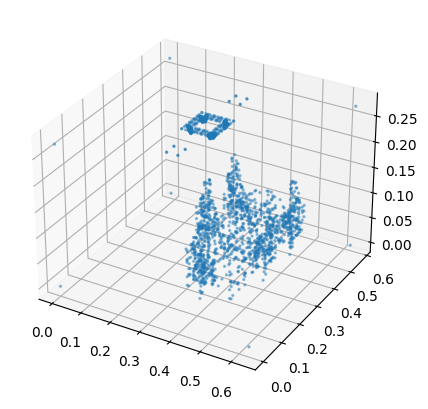

In [20]:
plot3d_points(pointCloudArray[0, :,:])

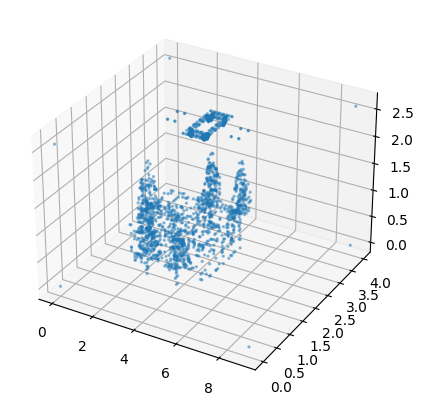

In [21]:
plot3d_points(sampledPointCloud_dict["office7"])

# モデル実装

In [22]:
from tensorflow.python.client import device_lib; print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 17839152154093244656
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 9967960064
locality {
  bus_id: 1
  links {
  }
}
incarnation: 16218408007540182610
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 3080 Ti, pci bus id: 0000:06:00.0, compute capability: 8.6"
xla_global_id: 416903419
]


2022-10-27 03:16:59.934281: I tensorflow/core/platform/cpu_feature_guard.cc:194] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-10-27 03:17:00.444724: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1553] Created device /device:GPU:0 with 9506 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3080 Ti, pci bus id: 0000:06:00.0, compute capability: 8.6


In [23]:
from tensorflow import keras
from PointNet import conv_bn, dense_bn


def permutation_invariant_network_builder(trial, inputs):
    """
    順序不変性（PointNetからtnetを除去したもの）モデルビルダー関数

    ハイパーパラメータを引数にとる（チューニング用）
    """

    x = inputs
    
    hp_conv_layers = trial.suggest_int('conv_bn_layers', 1, 4, step=1)
    for i in range(hp_conv_layers):
        hp_filters = trial.suggest_int(f'filters_bn-{i}', 32, 512, step=32)
        x = conv_bn(x, hp_filters)
    
    x = keras.layers.GlobalMaxPooling1D()(x)
    
    # Tune the dropout rate for the optimizer 
#     hp_dropout_rate = hp.Choice('dropout_rate', values = [0.3, 0.5, 0.9])
    
    hp_dense_layers = trial.suggest_int('dense_bn_layers', 0, 4, step=1)
    for i in range(hp_dense_layers):
        hp_units = trial.suggest_int(f'units_bn_{i}', 32, 512, step=32)
        x = dense_bn(x, hp_units)
#         x = keras.layers.Dropout(hp_dropout_rate)(x)

    hp_features = trial.suggest_int('features', 4, 64, step=4)
    features = keras.layers.Dense(hp_features)(x)
    hp_activation_pn = trial.suggest_categorical('activation_pn', ["None", "ReLU", "LeakyReLU", "ELU", "BatchNormalization"])
    if hp_activation_pn == "ReLU":
        features = keras.layers.ReLU()(features)
    elif hp_activation_pn == "LeakyReLU":
        features = keras.layers.LeakyReLU()(features)
    elif hp_activation_pn == "ELU":
        features = keras.layers.ELU()(features)
    elif hp_activation_pn == "BatchNormalization":
        features = keras.layers.BatchNormalization()(features)

    return features


In [24]:
NUM_POINTS = pointCloudArray.shape[1]

def total_model_builder(trial):
    """
    感染リスク分布予測モデル

    順序不変性モデルに、メタデータ（空調条件）を合流させ、
    転置畳み込みで感染リスク分布を出力する。

    KerasTunerから呼び出され、ハイパーパラメータをチューニングする
    """
    input_pointCloud = keras.Input(shape=(NUM_POINTS, 3), name='pointCloud')
    input_meta = keras.Input(shape=(metaArray.shape[1], ), name='meta')

    features_pc = permutation_invariant_network_builder(trial, input_pointCloud)
    
    features = keras.layers.Concatenate()([features_pc, input_meta])

    x = features
    
    hp_dense_layers = trial.suggest_int('dense_layers', 0, 4, step=1)
    hp_activation = trial.suggest_categorical('activation', ["ReLU", "LeakyReLU", "ELU"]) 
    
    for i in range(hp_dense_layers):
        hp_units = trial.suggest_int(f'units-{i}', 32, 512, step=32)
        x = keras.layers.Dense(hp_units)(x)
        if hp_activation == "ReLU":
            x = keras.layers.ReLU()(x)
        elif hp_activation == "LeakyReLU":
            x = keras.layers.LeakyReLU()(x)
        elif hp_activation == "ELU":
            x = keras.layers.ELU()(x)

    
    outputs = keras.layers.Dense(1)(x)

#     hp_learning_rate = hp.Choice('learning_rate', values = [1e-2, 1e-3, 1e-4]) 
    hp_learning_rate = trial.suggest_float('lr', 1e-5, 1e-1, log=True)
    model = keras.Model(inputs=[input_pointCloud, input_meta], outputs=outputs, name="predictionnet")
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
#         optimizer=keras.optimizers.RMSprop(learning_rate=hp_learning_rate),
        loss='mse',
        metrics=['mae']
        )

    return model



# チューニング

In [25]:
'''
特定のofficeだけ、テスト用にとっておく。
学習にも、チューニング中の検証にも使わない。
'''

office_for_test = 'office10'
fit_ID = []
test_ID = []

for (ID, case_index) in enumerate(case_index_augumented_list):
    if office_for_test + '_' not in case_index:
        fit_ID.append(ID)
    else:
        test_ID.append(ID)

print(case_index_array[test_ID])
        
case_index_fit = case_index_array[fit_ID]
X_pc_fit = pointCloudArray[fit_ID]
X_meta_fit = metaArray[fit_ID]
y_fit = RoIArray[fit_ID]

case_index_test = case_index_array[test_ID]
X_pc_test = pointCloudArray[test_ID]
X_meta_test = metaArray[test_ID]
y_test = RoIArray[test_ID]

['office10_0_0-0' 'office10_0_0-1' 'office10_0_0-2' 'office10_0_0-3'
 'office10_0_164_aout-0' 'office10_0_164_aout-1' 'office10_0_164_aout-2'
 'office10_0_164_aout-3' 'office10_0_164_bout-0' 'office10_0_164_bout-1'
 'office10_0_164_bout-2' 'office10_0_164_bout-3' 'office10_0_246_aout-0'
 'office10_0_246_aout-1' 'office10_0_246_aout-2' 'office10_0_246_aout-3'
 'office10_0_246_bout-0' 'office10_0_246_bout-1' 'office10_0_246_bout-2'
 'office10_0_246_bout-3' 'office10_0_82_aout-0' 'office10_0_82_aout-1'
 'office10_0_82_aout-2' 'office10_0_82_aout-3' 'office10_0_82_bout-0'
 'office10_0_82_bout-1' 'office10_0_82_bout-2' 'office10_0_82_bout-3'
 'office10_360_0-0' 'office10_360_0-1' 'office10_360_0-2'
 'office10_360_0-3' 'office10_360_164_aout-0' 'office10_360_164_aout-1'
 'office10_360_164_aout-2' 'office10_360_164_aout-3'
 'office10_360_164_bout-0' 'office10_360_164_bout-1'
 'office10_360_164_bout-2' 'office10_360_164_bout-3'
 'office10_360_246_aout-0' 'office10_360_246_aout-1'
 'office10_36

In [ ]:
office_list = sampledPointCloud_dict

In [26]:
from k_cross_split import get_k_cross_ID_list

'''
チューニングに使うデータを，学習用と検証用に分ける
'''

data_size = len(X_pc_fit)
k = 4
print('data_size =', data_size)
print('k =', k)

#k分割交差検証用の関数だが、ここでは単に訓練データと検証データの分割目的で使う
k_cross_ID_list = get_k_cross_ID_list(data_size, k)

(train_ID, val_ID) = k_cross_ID_list[0]
print(train_ID)
print(val_ID)

X_pc_train = X_pc_fit[train_ID]
X_meta_train = X_meta_fit[train_ID]
y_train = y_fit[train_ID]

X_pc_val = X_pc_fit[val_ID]
X_meta_val = X_meta_fit[val_ID]
y_val = y_fit[val_ID]

data_size = 1612
k = 4
[372, 1526, 588, 1516, 1096, 1365, 410, 870, 21, 360, 756, 286, 1269, 830, 879, 1451, 477, 1287, 541, 716, 1591, 1265, 1527, 502, 432, 1523, 747, 553, 577, 1386, 1409, 1385, 1166, 1357, 11, 412, 474, 1066, 250, 679, 76, 657, 688, 125, 1455, 244, 1323, 27, 1276, 1199, 1515, 824, 188, 721, 1227, 1557, 928, 1308, 382, 1004, 1123, 1223, 301, 509, 520, 1482, 111, 1464, 449, 676, 1120, 459, 1400, 618, 121, 557, 554, 279, 876, 317, 702, 1558, 1382, 561, 1479, 485, 1344, 256, 1221, 630, 130, 993, 851, 801, 1354, 436, 867, 225, 366, 1272, 296, 737, 1157, 334, 431, 494, 43, 82, 802, 123, 1070, 117, 1499, 1188, 628, 732, 25, 1436, 1611, 468, 1264, 762, 1101, 516, 833, 753, 1592, 289, 390, 703, 790, 139, 1045, 1197, 1362, 487, 627, 640, 987, 537, 635, 752, 343, 988, 1151, 413, 972, 901, 1599, 488, 1473, 1079, 845, 1405, 1062, 1284, 430, 811, 476, 373, 1312, 772, 1416, 938, 590, 1172, 458, 454, 925, 578, 1367, 112, 638, 595, 816, 369, 506, 653, 67, 19, 147, 1038, 448, 556, 15

In [27]:
X_pc_train.shape

(1209, 2048, 3)

In [28]:
# import shutil
# import datetime

# # if os.path.exists(output_dir):
# #     shutil.rmtree(output_dir)

# # projectName = 'trial' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# projectName = "trial20221019-034805"
# print("projectName : " + projectName)

# output_dir = './KerasTuner_log'

# # if os.path.exists(output_dir):
# #     shutil.rmtree(output_dir)

# tuner = kt.Hyperband(
#     total_model_builder,
# #     MyHyperModel(),
#     objective = 'val_loss', 
#     max_epochs = 1000,
#     #  factor = 3,
#     directory = output_dir,
#     project_name = projectName
#     )


In [29]:
# import tensorflow as tf
# from tensorflow.keras.callbacks import EarlyStopping

# logdir = os.path.join("tblogs", projectName)
# tensorboard_cb = keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)

# print("logdir : ", logdir)

# class ClearTrainingOutput(tf.keras.callbacks.Callback):
#     def on_train_end(*args, **kwargs):
#         IPython.display.clear_output(wait = True)

# estop_tuning =  EarlyStopping(monitor='val_loss', min_delta=0.0, patience=40)


In [30]:
# case_index_train = case_index_array[train_ID]
# case_index_test = case_index_array[test_ID]

In [31]:
# tuner.search({'pointCloud':X_pc_train, 'meta':X_meta_train}, Y_train,
#              epochs = 40,
#              validation_data = ({'pointCloud':X_pc_test, 'meta':X_meta_test}, Y_test),
#              callbacks = [ClearTrainingOutput()])

In [36]:
from tensorflow.keras.callbacks import EarlyStopping
import optuna
from keras.backend import clear_session

estop_tuning =  EarlyStopping(monitor='val_loss', min_delta=0.0, patience=20)


# 1. Define an objective function to be maximized.
# def objective(trial, X_dict_train, y_train, X_dict_val, y_val):
def objective(trial):
    # Clear clutter from previous Keras session graphs.
    clear_session()
    
    # 変更点1: データを各trial用にコピーする
#     X_pc_train_copy = np.copy(X_pc_train)
#     X_meta_train_copy = np.copy(X_meta_train)
#     y_train_copy = np.copy(y_train)
    
#     X_pc_val_copy = np.copy(X_pc_val)
#     X_meta_val_copy = np.copy(X_meta_val)
#     y_val_copy = np.copy(y_val)

    X_pc_train_ = X_pc_train
    X_meta_train_ = X_meta_train
    y_train_ = y_train
    
    X_pc_val_ = X_pc_val
    X_meta_val_ = X_meta_val
    y_val_ = y_val
    
    model = total_model_builder(trial)
    
    hp_batch_size = trial.suggest_categorical('batch_size', [1, 4, 16, 64, 128, 256])
#     hp_batch_size = trial.suggest_categorical('batch_size', [1, 4, 16, 64, 128, 256, 512])
    
    model.fit(
        {'pointCloud':X_pc_train_, 'meta':X_meta_train_}, y_train_,
        validation_data = ({'pointCloud':X_pc_val_, 'meta':X_meta_val_}, y_val_),
        epochs = 1000,
        batch_size=hp_batch_size,
        callbacks = [estop_tuning],
        verbose=False,
    )

    evaluate = model.evaluate({'pointCloud':X_pc_val_, 'meta':X_meta_val_}, y_val_, verbose=0)
        
    return evaluate[0] #:MSE


In [37]:
study_name = 'example-study'
db_path = '/mnt/MachineLearning/Optuna_log/optuna_study.db'

# 3. Create a study object and optimize the objective function.
# study = optuna.create_study(direction='minimize')

study = optuna.create_study(
    direction='minimize',
    study_name=study_name,
    storage='sqlite:///'+db_path,
    load_if_exists=True
)

study.optimize(objective, n_trials=100, gc_after_trial=True)

[I 2022-10-27 05:11:38,854] A new study created in memory with name: no-name-848b672a-39ce-4fc2-8681-b9ce38e707e9
[I 2022-10-27 05:12:10,607] Trial 0 finished with value: 0.2532356381416321 and parameters: {'conv_bn_layers': 2, 'filters_bn-0': 320, 'filters_bn-1': 192, 'dense_bn_layers': 3, 'units_bn_0': 448, 'units_bn_1': 32, 'units_bn_2': 224, 'features': 24, 'activation_pn': 'BatchNormalization', 'dense_layers': 0, 'activation': 'ReLU', 'lr': 0.012597851569334777, 'batch_size': 256}. Best is trial 0 with value: 0.2532356381416321.
[I 2022-10-27 05:16:06,810] Trial 1 finished with value: 12399880962048.0 and parameters: {'conv_bn_layers': 3, 'filters_bn-0': 448, 'filters_bn-1': 32, 'filters_bn-2': 448, 'dense_bn_layers': 4, 'units_bn_0': 192, 'units_bn_1': 64, 'units_bn_2': 32, 'units_bn_3': 32, 'features': 60, 'activation_pn': 'None', 'dense_layers': 1, 'activation': 'ReLU', 'units-0': 480, 'lr': 0.020435802276953036, 'batch_size': 1}. Best is trial 0 with value: 0.2532356381416321.

In [44]:
print("Number of finished trials: {}".format(len(study.trials)))

print("Best trial:")
best_trial = study.best_trial

print("  Value: {}".format(best_trial.value))

print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 100
Best trial:
  Value: 0.0041619352996349335
  Params: 
    conv_bn_layers: 4
    filters_bn-0: 320
    filters_bn-1: 256
    filters_bn-2: 416
    filters_bn-3: 352
    dense_bn_layers: 0
    features: 32
    activation_pn: None
    dense_layers: 4
    activation: ReLU
    units-0: 384
    units-1: 64
    units-2: 448
    units-3: 128
    lr: 0.002257363592876592
    batch_size: 128


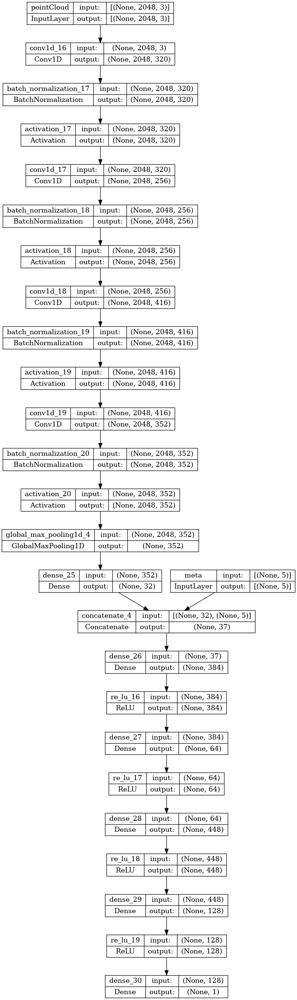

In [45]:
best_model = total_model_builder(best_trial)
keras.utils.plot_model(best_model, show_shapes=True)

In [113]:
import gc
 
gc.collect()

5537

In [98]:
# tuner.search({'pointCloud':X_pc_train, 'meta':X_meta_train}, y_train,
#              epochs = 1000,
# #              batch_size = 256,
#              validation_data = ({'pointCloud':X_pc_val, 'meta':X_meta_val}, y_val),
#              callbacks = [estop_tuning, tensorboard_cb])
# #              callbacks = [estop_tuning, ClearTrainingOutput(), tensorboard_cb])

In [43]:
# tuner.results_summary()

In [46]:
# Get the optimal hyperparameters
# best_hps = tuner.get_best_hyperparameters(num_trials = 1)[0]
# best_hps = tuner.get_best_hyperparameters()[0]

# best_conv_layers =best_hps.get('conv_bn_layers')
# print('best_conv_bn_layers = ', best_conv_layers)
# for i in range(best_conv_layers):
#     print(best_hps.get(f'filters_bn-{i}'))
    
# best_dense_layers =best_hps.get('dense_bn_layers')
# print('best_dense_layers = ', best_dense_layers)
# for i in range(best_dense_layers):
#     print(best_hps.get(f'units_bn_{i}'))

# print('best_features = ', best_hps.get('features'))
    
# print('best_learning_rate = ', best_hps.get('learning_rate'))

In [42]:
# Build the model with the optimal hyperparameters
# model = tuner.hypermodel.build(best_hps)

# keras.utils.plot_model(model, show_shapes=True)


In [47]:
from tensorflow.keras.callbacks import EarlyStopping

best_model = total_model_builder(best_trial)

estop =  EarlyStopping(monitor='val_loss', min_delta=0.0, patience=20)

best_history = best_model.fit(
    {'pointCloud':X_pc_train, 'meta':X_meta_train}, y_train,
    batch_size = 128,
    epochs = 1000,
    validation_data = ({'pointCloud':X_pc_val, 'meta':X_meta_val}, y_val),
    callbacks=[estop]
)

Epoch 1/1000
10/10 [==============================] - 3s 150ms/step - loss: 4.8308 - mae: 1.4491 - val_loss: 0.9495 - val_mae: 0.7682
Epoch 2/1000
10/10 [==============================] - 1s 126ms/step - loss: 0.8503 - mae: 0.7391 - val_loss: 0.8454 - val_mae: 0.7167
Epoch 3/1000
10/10 [==============================] - 1s 123ms/step - loss: 0.6563 - mae: 0.6595 - val_loss: 0.4650 - val_mae: 0.5385
Epoch 4/1000
10/10 [==============================] - 1s 125ms/step - loss: 0.6857 - mae: 0.6721 - val_loss: 0.6270 - val_mae: 0.6066
Epoch 5/1000
10/10 [==============================] - 1s 122ms/step - loss: 0.4799 - mae: 0.5449 - val_loss: 0.5060 - val_mae: 0.5981
Epoch 6/1000
10/10 [==============================] - 1s 122ms/step - loss: 0.4045 - mae: 0.5052 - val_loss: 0.3438 - val_mae: 0.4673
Epoch 7/1000
10/10 [==============================] - 1s 131ms/step - loss: 0.3171 - mae: 0.4386 - val_loss: 0.2710 - val_mae: 0.4029
Epoch 8/1000
10/10 [==============================] - 1s 121ms

In [48]:
from tensorflow.keras.callbacks import EarlyStopping

best_model = total_model_builder(best_trial)

estop =  EarlyStopping(monitor='val_loss', min_delta=0.0, patience=100)

test_history = best_model.fit(
    {'pointCloud':X_pc_fit, 'meta':X_meta_fit}, y_fit,
    batch_size = 128,
    epochs = 1000,
    validation_data = ({'pointCloud':X_pc_test, 'meta':X_meta_test}, y_test),
    callbacks=[estop]
)

Epoch 1/1000
13/13 [==============================] - 3s 154ms/step - loss: 3.5188 - mae: 1.2761 - val_loss: 3.8427 - val_mae: 1.7590
Epoch 2/1000
13/13 [==============================] - 1s 115ms/step - loss: 0.8360 - mae: 0.7331 - val_loss: 2.3856 - val_mae: 1.3505
Epoch 3/1000
13/13 [==============================] - 2s 115ms/step - loss: 0.4663 - mae: 0.5432 - val_loss: 0.8218 - val_mae: 0.7124
Epoch 4/1000
13/13 [==============================] - 2s 116ms/step - loss: 0.5191 - mae: 0.5808 - val_loss: 0.9268 - val_mae: 0.7630
Epoch 5/1000
13/13 [==============================] - 1s 115ms/step - loss: 0.4172 - mae: 0.5135 - val_loss: 0.7774 - val_mae: 0.6940
Epoch 6/1000
13/13 [==============================] - 1s 115ms/step - loss: 0.2685 - mae: 0.4050 - val_loss: 0.9180 - val_mae: 0.7555
Epoch 7/1000
13/13 [==============================] - 1s 115ms/step - loss: 0.2463 - mae: 0.3803 - val_loss: 0.9305 - val_mae: 0.7643
Epoch 8/1000
13/13 [==============================] - 2s 119ms

# チューニング結果確認

In [50]:
import pandas as pd

def plot_history(history:dict, ymax:float=None):
    history_df = pd.DataFrame(history)
    
    loss_df = history_df[["loss", "val_loss"]]
    loss_df.plot()
    plt.xlabel("epochs")
    plt.ylabel("Loss")
    if ymax is not None:
        plt.ylim(0., ymax)
    plt.show()

    acc_df = history_df[["mae", "val_mae"]]
    acc_df.plot()
    plt.xlabel("epochs")
    plt.ylabel("MeanAbsoluteError")
    plt.show()

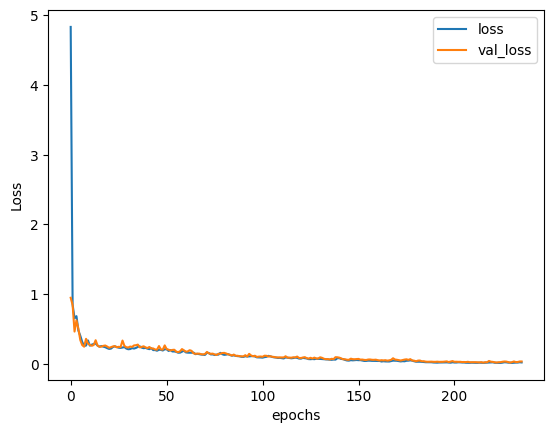

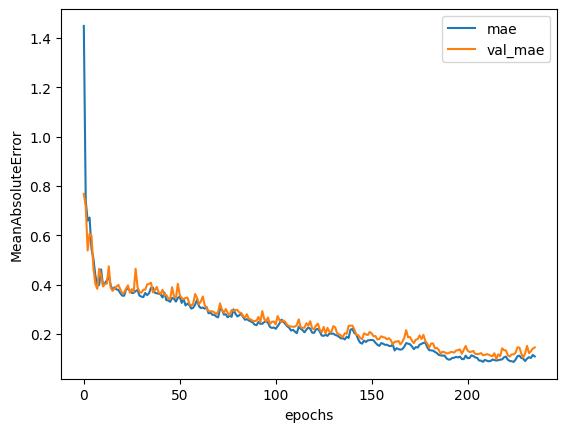

In [51]:
plot_history(best_history.history)

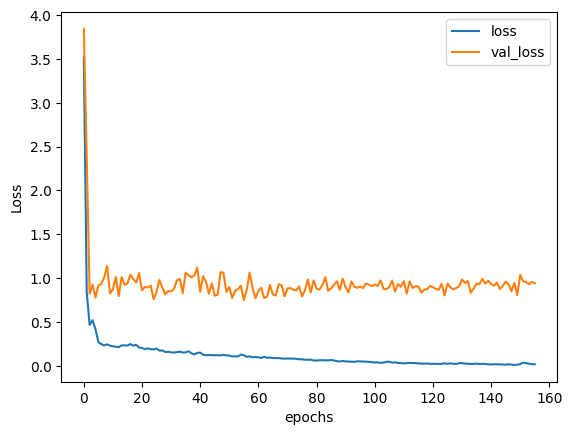

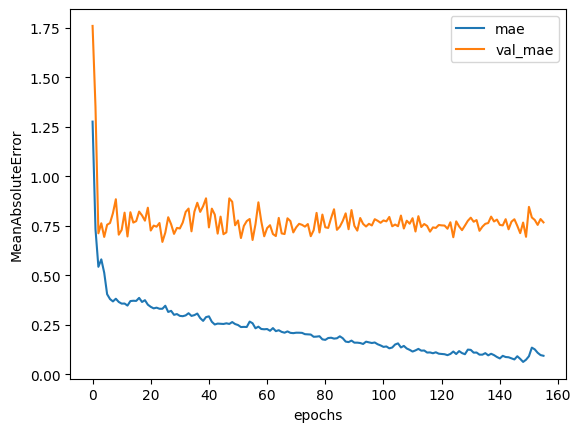

In [52]:
plot_history(test_history.history)

In [65]:
X_pc_train.shape

(1209, 2048, 3)

In [66]:
from tensorflow.keras.callbacks import EarlyStopping

estop =  EarlyStopping(monitor='val_loss', min_delta=0.0, patience=20)

batch_size_list = [1, 4, 16, 64, 128, 256, 512, None]
# batch_size_list = [128, 512]

history_dict = {}

for batch_size in batch_size_list:
    print("===========================================================")
    print("batch_size : ", batch_size)
    print("===========================================================")
    
    # Build the model with the optimal hyperparameters
    model = tuner.hypermodel.build(best_hps)

    history = model.fit(
        {'pointCloud':X_pc_train, 'meta':X_meta_train}, y_train,
        batch_size = batch_size,
        epochs = 1000,
        verbose = 0,
        validation_data = ({'pointCloud':X_pc_val, 'meta':X_meta_val}, y_val),
        callbacks=[estop]
    )
    
    history_dict[batch_size] = history
    

batch_size :  1
batch_size :  4
batch_size :  16
batch_size :  64
batch_size :  128
batch_size :  256
batch_size :  512


2022-10-21 07:14:12.253097: W tensorflow/core/common_runtime/bfc_allocator.cc:479] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.00GiB (rounded to 2147483648)requested by op gradient_tape/predictionnet/batch_normalization_49/moments/BroadcastTo_1
If the cause is memory fragmentation maybe the environment variable 'TF_GPU_ALLOCATOR=cuda_malloc_async' will improve the situation. 
Current allocation summary follows.
Current allocation summary follows.
2022-10-21 07:14:12.260821: I tensorflow/core/common_runtime/bfc_allocator.cc:1027] BFCAllocator dump for GPU_0_bfc
2022-10-21 07:14:12.260875: I tensorflow/core/common_runtime/bfc_allocator.cc:1034] Bin (256): 	Total Chunks: 136212, Chunks in use: 136211. 33.25MiB allocated for chunks. 33.25MiB in use in bin. 563.4KiB client-requested in use in bin.
2022-10-21 07:14:12.260887: I tensorflow/core/common_runtime/bfc_allocator.cc:1034] Bin (512): 	Total Chunks: 361, Chunks in use: 359. 224.5KiB allocated for chunks. 223.2KiB in u

ResourceExhaustedError: Graph execution error:

Detected at node 'gradient_tape/predictionnet/batch_normalization_49/moments/BroadcastTo_1' defined at (most recent call last):
    File "/usr/lib/python3.8/runpy.py", line 194, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "/usr/lib/python3.8/runpy.py", line 87, in _run_code
      exec(code, run_globals)
    File "/usr/local/lib/python3.8/dist-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/usr/local/lib/python3.8/dist-packages/traitlets/config/application.py", line 978, in launch_instance
      app.start()
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/kernelapp.py", line 712, in start
      self.io_loop.start()
    File "/usr/local/lib/python3.8/dist-packages/tornado/platform/asyncio.py", line 199, in start
      self.asyncio_loop.run_forever()
    File "/usr/lib/python3.8/asyncio/base_events.py", line 570, in run_forever
      self._run_once()
    File "/usr/lib/python3.8/asyncio/base_events.py", line 1859, in _run_once
      handle._run()
    File "/usr/lib/python3.8/asyncio/events.py", line 81, in _run
      self._context.run(self._callback, *self._args)
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/kernelbase.py", line 510, in dispatch_queue
      await self.process_one()
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/kernelbase.py", line 499, in process_one
      await dispatch(*args)
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/kernelbase.py", line 406, in dispatch_shell
      await result
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/kernelbase.py", line 730, in execute_request
      reply_content = await reply_content
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py", line 383, in do_execute
      res = shell.run_cell(
    File "/usr/local/lib/python3.8/dist-packages/ipykernel/zmqshell.py", line 528, in run_cell
      return super().run_cell(*args, **kwargs)
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py", line 2885, in run_cell
      result = self._run_cell(
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py", line 2940, in _run_cell
      return runner(coro)
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/async_helpers.py", line 129, in _pseudo_sync_runner
      coro.send(None)
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py", line 3139, in run_cell_async
      has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py", line 3318, in run_ast_nodes
      if await self.run_code(code, result, async_=asy):
    File "/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py", line 3378, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "/tmp/ipykernel_1907269/1105657914.py", line 18, in <module>
      history = model.fit(
    File "/usr/local/lib/python3.8/dist-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1409, in fit
      tmp_logs = self.train_function(iterator)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1051, in train_function
      return step_function(self, iterator)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1040, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1030, in run_step
      outputs = model.train_step(data)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 893, in train_step
      self.optimizer.minimize(loss, self.trainable_variables, tape=tape)
    File "/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/optimizer_v2.py", line 537, in minimize
      grads_and_vars = self._compute_gradients(
    File "/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/optimizer_v2.py", line 590, in _compute_gradients
      grads_and_vars = self._get_gradients(tape, loss, var_list, grad_loss)
    File "/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/optimizer_v2.py", line 471, in _get_gradients
      grads = tape.gradient(loss, var_list, grad_loss)
Node: 'gradient_tape/predictionnet/batch_normalization_49/moments/BroadcastTo_1'
OOM when allocating tensor with shape[512,2048,512] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[{{node gradient_tape/predictionnet/batch_normalization_49/moments/BroadcastTo_1}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_train_function_171881085]

batch_size :  1


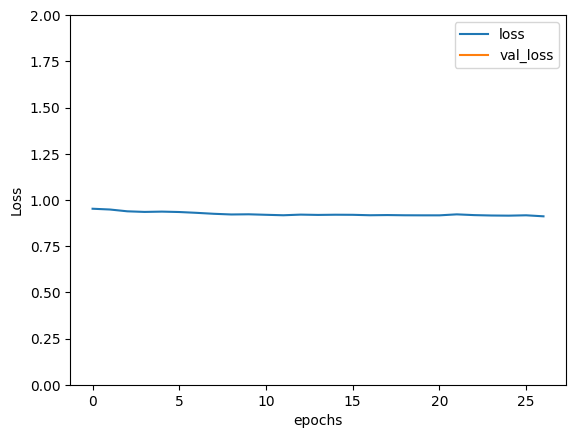

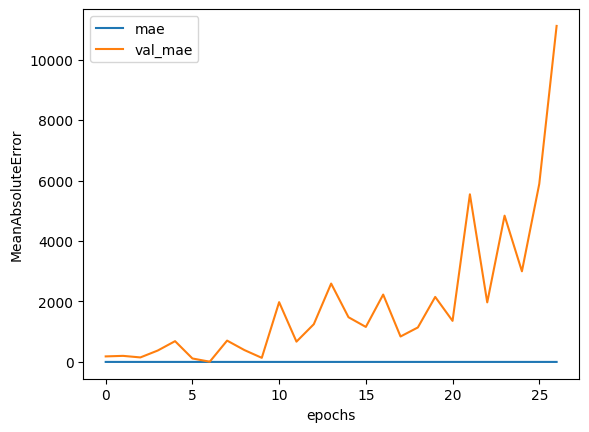

batch_size :  4


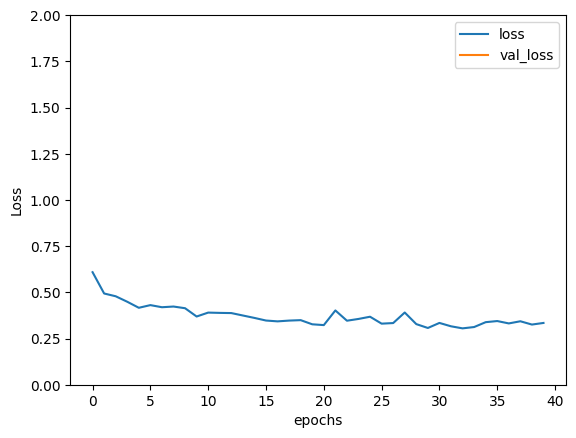

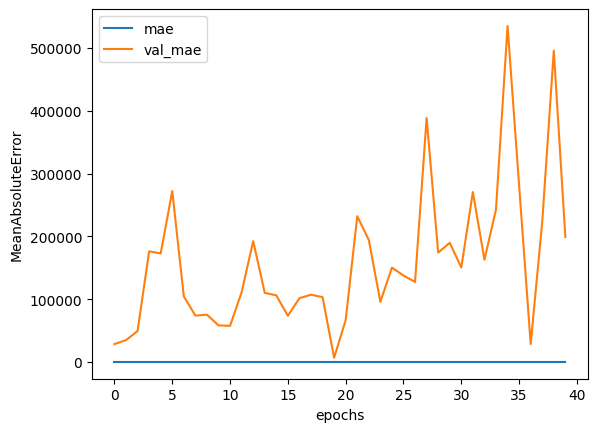

batch_size :  16


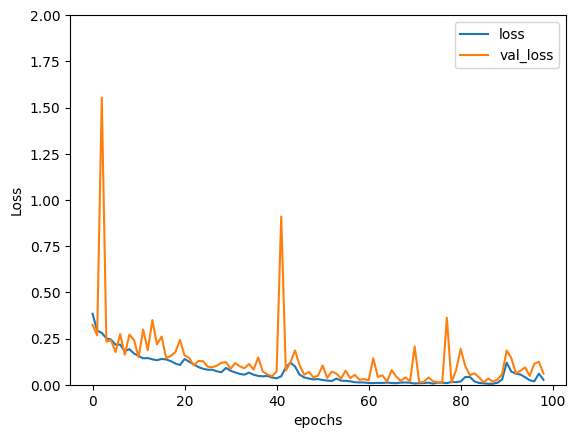

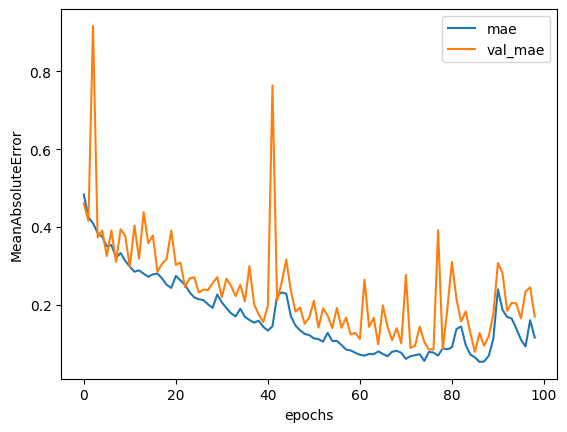

batch_size :  64


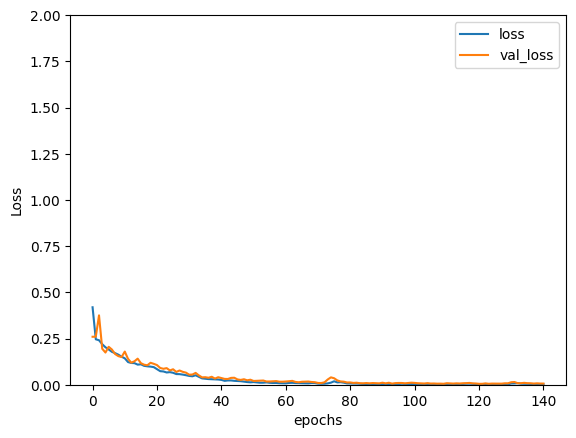

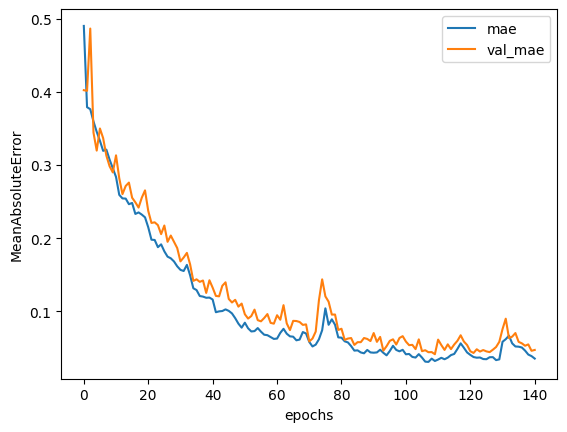

batch_size :  128


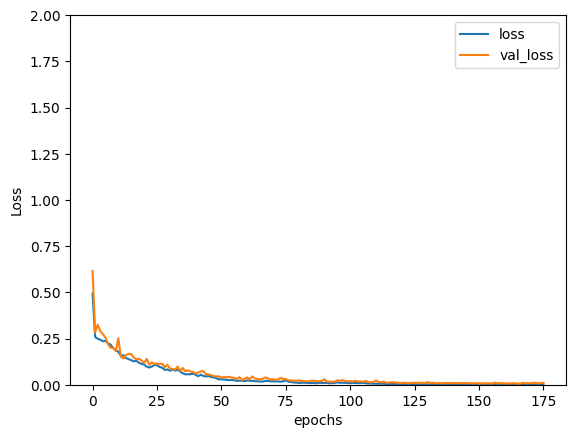

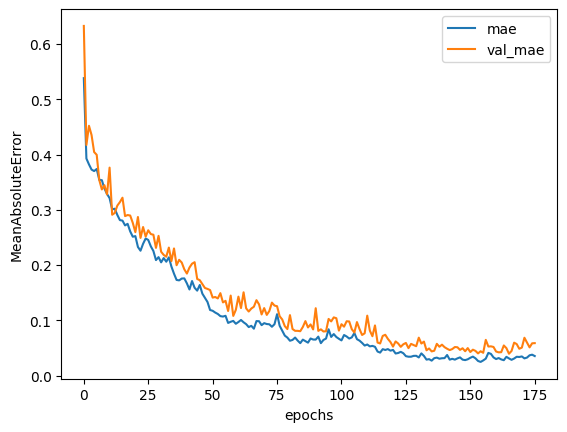

batch_size :  256


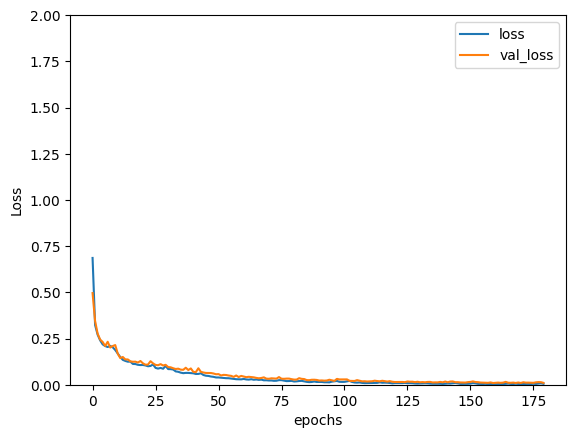

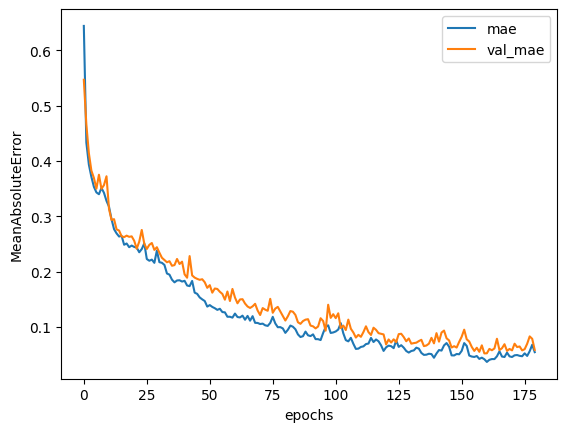

batch_size :  512


KeyError: 512

In [67]:
batch_size_list = [1, 4, 16, 64, 128, 256, 512, None]

for batch_size in batch_size_list:
    print("===========================================================")
    print("batch_size : ", batch_size)
    print("===========================================================")
    plot_history(history_dict[batch_size].history, ymax=2.)

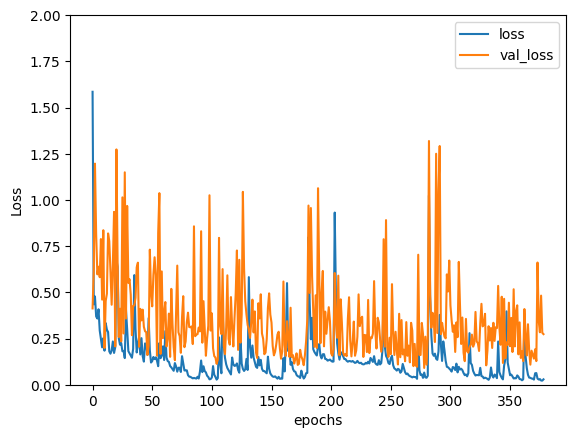

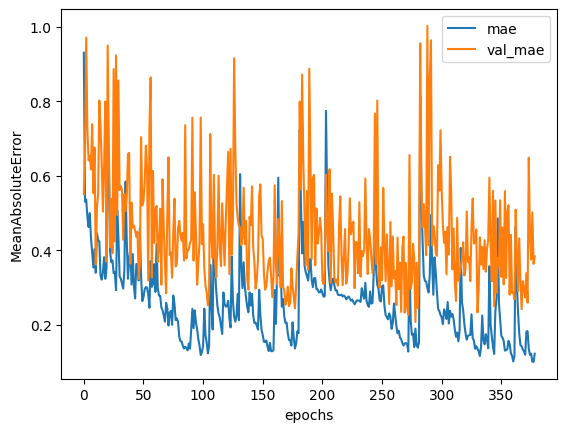

In [188]:
plot_history(best_history.history)

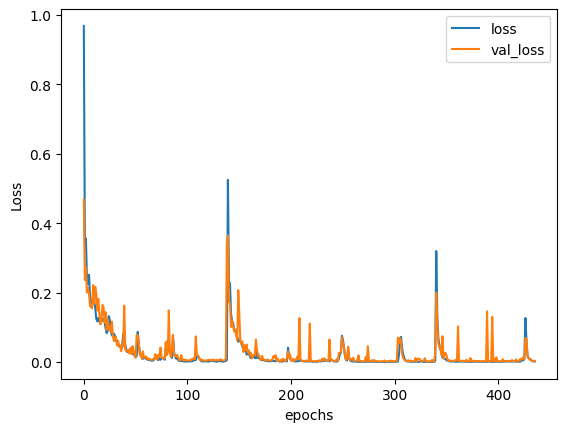

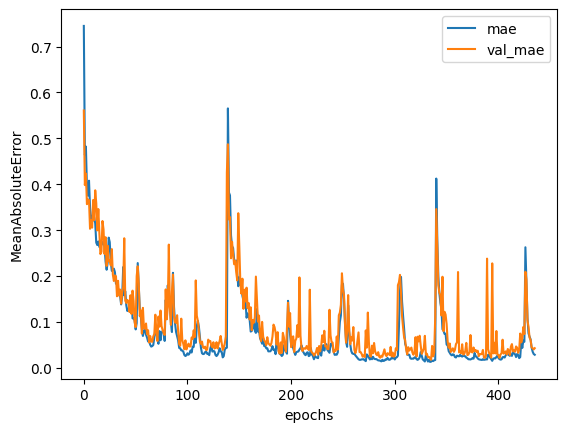

In [221]:
plot_history(best_history.history)

In [49]:
Y_train_pred = model.predict({'pointCloud':X_pc_train, 'meta':X_meta_train})
Y_test_pred = model.predict({'pointCloud':X_pc_test, 'meta':X_meta_test})

4/4 [==============================] - 0s 4ms/step


In [50]:
np.var(y_test)

0.7378512178226752

In [51]:
test_mse, test_mae = model.evaluate({'pointCloud':X_pc_test, 'meta':X_meta_test}, y_test, verbose=0)

print(test_mse)

print(test_mae)

1.0614726543426514
0.8605452179908752


# いよいよ手詰まり状態

**残された手段**

*   点群データを調節
 *   現在、1点群あたりの点の数は2048個に統一
 *   点群データの作り方もいろいろある
 *   モデルから人体モデルだけ取り除く（現状、全点群のうち人体表面の頂点が多くを占める）
 *   エアコン・換気口を構成する頂点は必ずサンプリング 
*   点群を諦め、部屋のサイズを説明変数（入力）に加える
 *   ニューラルネットワークすらも諦め、重回帰へ（線形・非線形）
*   座っている位置と立っている位置とで観測飛沫数データを足し算した場合に分散は大きくなるだろうか（要確認）
* RNN
* 微分方程式を機械学習で解く
* 感染リスク定義見直し
* 分類問題へ
* 

いずれも大きな効果はあまり期待できそうにない・・・

